# Reto 03
A continuación, tu tarea será desarrollar 3 modelos distintos de Machine Learning para clasificar nuevos casos que pueden estar en riesgo de sufrir un paro cardiaco. A continuación te presento la información de acda una de las variables:
- age: edad de la persona
- sexo: género de la persona, 1 para hombre y 0 para mujer
- cp: tipo de dolor de pecho
- trtbps: presión arterial en reposo (en mm Hg)
- chol: colestorol en mg / dl
- fbs: (azúcar en sangre en ayunas> 120 mg / dl) (1 = verdadero; 0 = falso)
- restecg: resultados electrocardiográficos en reposo
- thalachh: frecuencia cardíaca máxima alcanzada
- exng: angina inducida por ejercicio (1 = sí; 0 = no)
- oldpeak: pico anterior
- output: indica si la parsona tuvo un infarto (1 si; 0 no)

Siga los pasos a continuación. Éxito.

# Paso 01
Para este primer paso deberá empezar a generar un breve EDA con los siguientes requerimientos:
- Genere barplots o histogramas de al menos 1 variable de su interés
- Exploré la cantidad total de personas con infartos y sin infartos, su edad correspondiente y sexo.
- Grafique con ayuda de matplotlib y de seaborn una matriz de correlación

In [1]:
# 0.1 Para leer  archivos desde la nube
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [2]:
# 0.2 Autenticar gmail
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [3]:
# 0.3 Obtener el archivo
downloaded = drive.CreateFile({'id':'1-ZQ7CyfZ4Kqd6DeSRRWyHCsJ9RiwRBFb'}) # replace the id with id of file you want to access
downloaded.GetContentFile('heart.csv')

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
df = pd.read_csv('heart.csv')

df.describe()

,age,sex,cp,trtbps,chol,fbs,restecg,thalachh,exng,oldpeak,slp,caa,thall,output
count,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000
mean,54.366337,0.683168,0.966997,131.623762,246.264026,0.148515,0.528053,149.646865,0.326733,1.039604,1.399340,0.729373,2.313531,0.544554
std,9.082101,0.466011,1.032052,17.538143,51.830751,0.356198,0.525860,22.905161,0.469794,1.161075,0.616226,1.022606,0.612277,0.498835
min,29.000000,0.000000,0.000000,94.000000,126.000000,0.000000,0.000000,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,47.500000,0.000000,0.000000,120.000000,211.000000,0.000000,0.000000,133.500000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000
50%,55.000000,1.000000,1.000000,130.000000,240.000000,0.000000,1.000000,153.000000,0.000000,0.800000,1.000000,0.000000,2.000000,1.000000
75%,61.000000,1.000000,2.000000,140.000000,274.500000,0.000000,1.000000,166.000000,1.000000,1.600000,2.000000,1.000000,3.000000,1.000000
max,77.000000,1.000000,3.000000,200.000000,564.000000,1.000000,2.000000,202.000000,1.000000,6.200000,2.000000,4.000000,3.000000,1.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 303 entries, 0 to 302
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       303 non-null    int64  
 1   sex       303 non-null    int64  
 2   cp        303 non-null    int64  
 3   trtbps    303 non-null    int64  
 4   chol      303 non-null    int64  
 5   fbs       303 non-null    int64  
 6   restecg   303 non-null    int64  
 7   thalachh  303 non-null    int64  
 8   exng      303 non-null    int64  
 9   oldpeak   303 non-null    float64
 10  slp       303 non-null    int64  
 11  caa       303 non-null    int64  
 12  thall     303 non-null    int64  
 13  output    303 non-null    int64  
dtypes: float64(1), int64(13)
memory usage: 33.3 KB


In [6]:
df.head()

,age,sex,cp,trtbps,chol,fbs,restecg,thalachh,exng,oldpeak,slp,caa,thall,output
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1


C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='sex', ylabel='Density'>

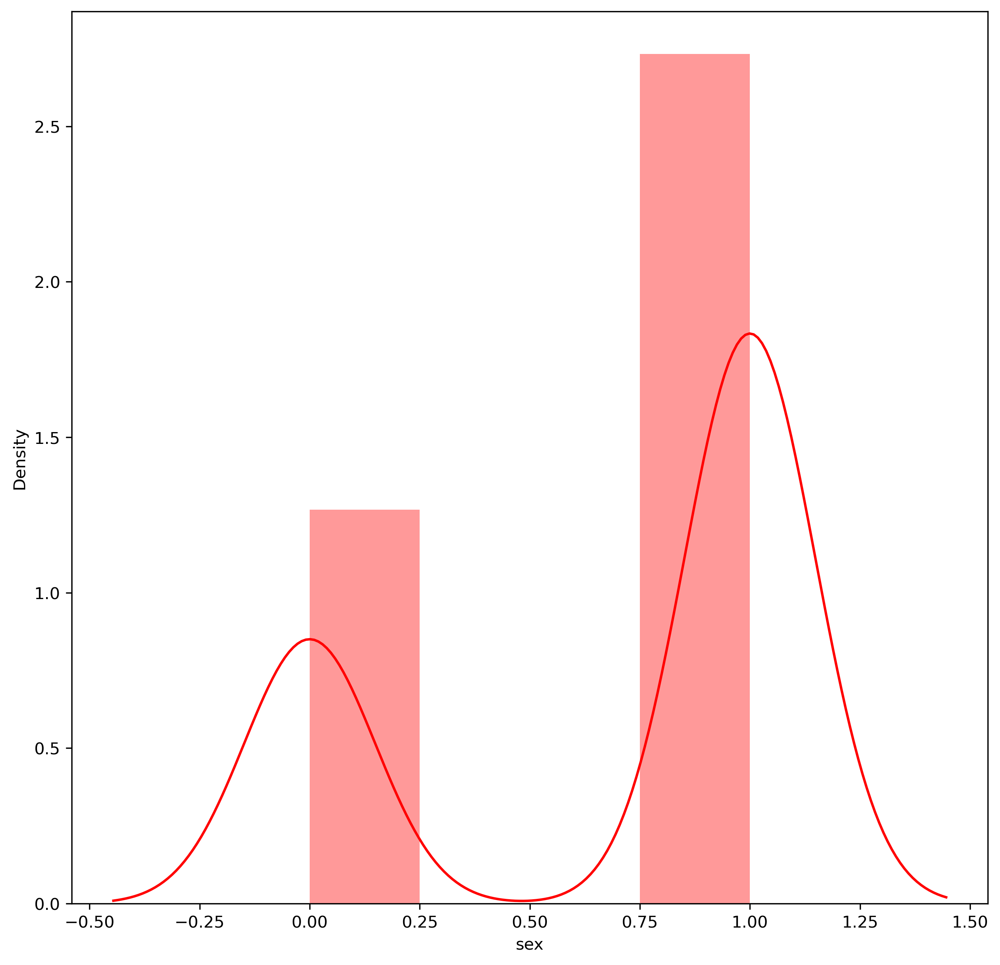

In [4]:
plt.figure(figsize=(10,10), dpi = 300) 
sns.distplot(df.sex, color='red')

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='output', ylabel='Density'>

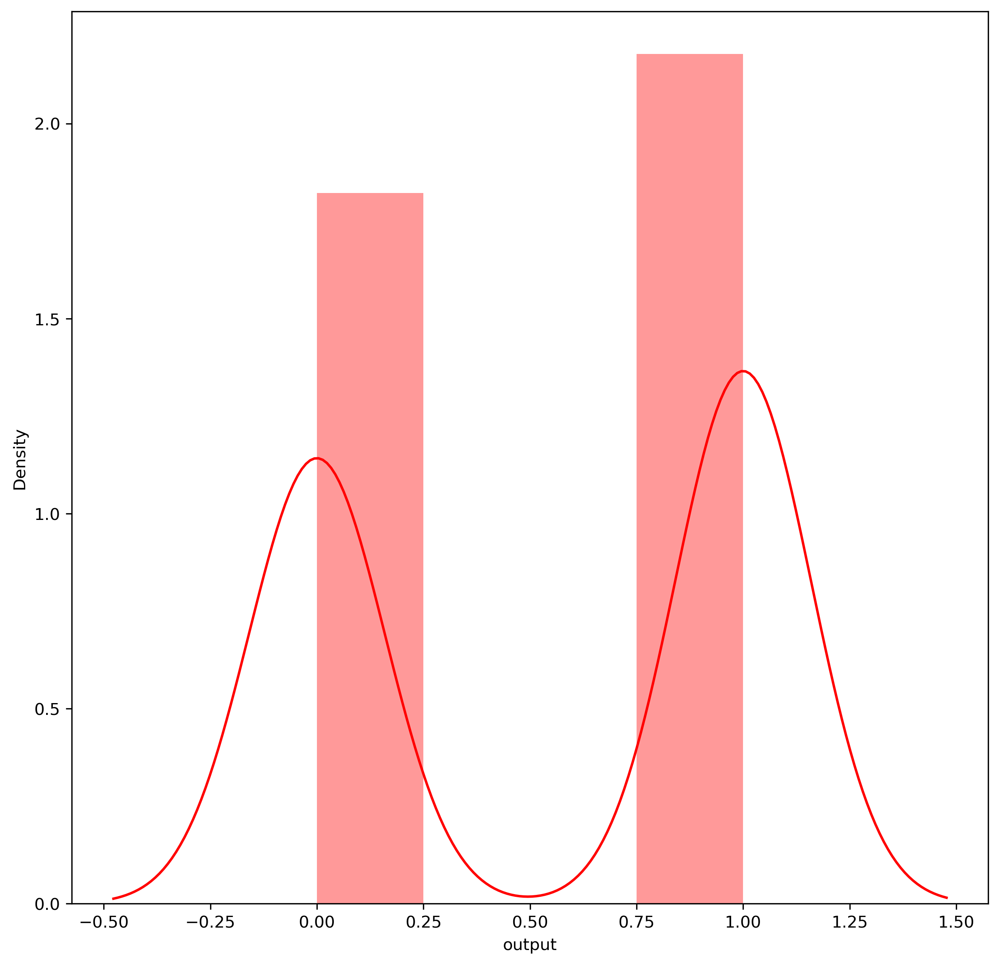

In [ ]:
plt.figure(figsize=(10,10), dpi = 300) 
sns.distplot(df.output, color='red')

In [5]:
hattack= df[df['output']==1] 

C:\Users\Pelu\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


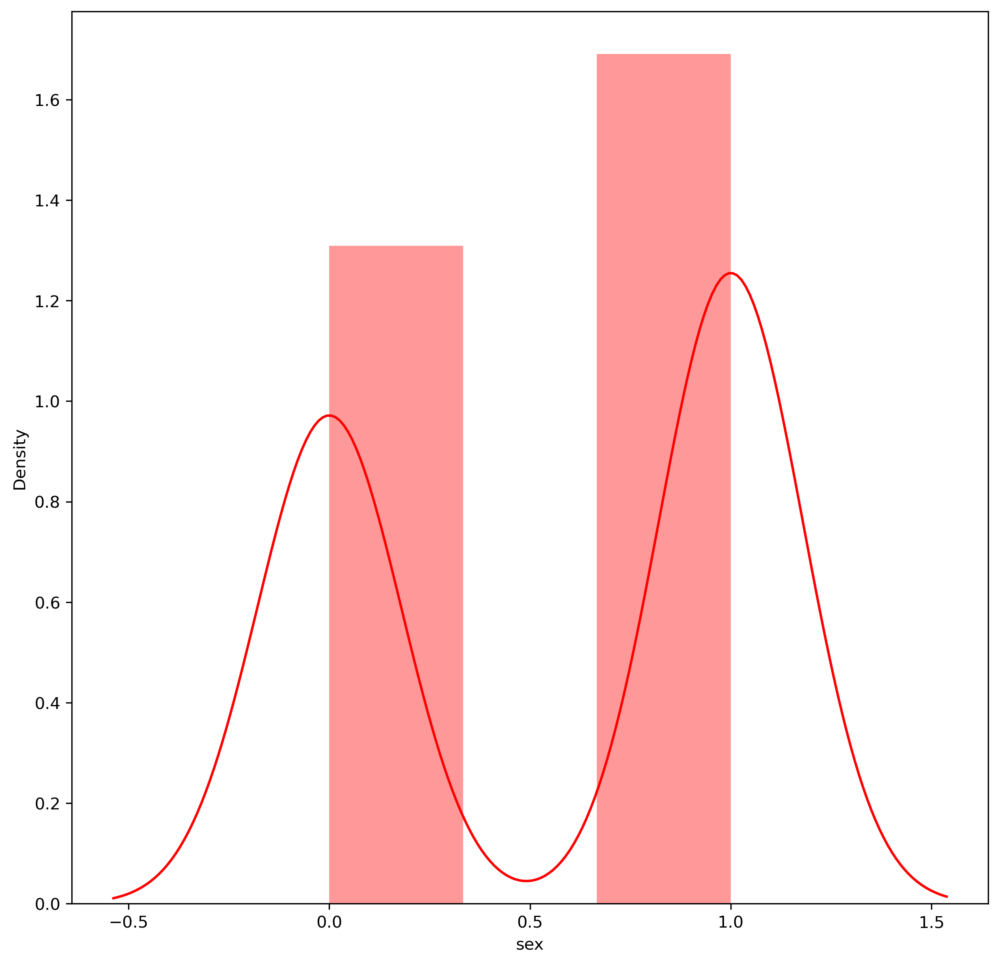

In [6]:
plt.figure(figsize=(10,10), dpi = 300) 
sns.distplot(hattack.sex, color='red')

In [7]:
!pip install dataprep

  Created wheel for metaphone: filename=Metaphone-0.6-py3-none-any.whl size=13905 sha256=06e1ba75170f6d90e6079d29e577622692d95e66ef2196006fee21c7fbe63a41
  Stored in directory: c:\users\jaffo\appdata\local\pip\cache\wheels\ea\4e\3b\0634f08a7980461ad630fa4147cbd25913b008b4a02992ba66
Successfully built metaphone
  Attempting uninstall: regex
    Found existing installation: regex 2021.4.4
    Uninstalling regex-2021.4.4:
      Successfully uninstalled regex-2021.4.4
  Attempting uninstall: dask
    Found existing installation: dask 2021.4.0
    Uninstalling dask-2021.4.0:
      Successfully uninstalled dask-2021.4.0


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
distributed 2021.4.0 requires dask>=2021.03.0, but you have dask 2.30.0 which is incompatible.


In [8]:
from dataprep.eda import create_report
report = create_report(df, title='EDA')

  0%|          | 0/1692 [00:00<?, ?it/s]

EDA
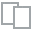
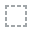
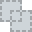
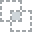
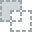
...
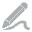
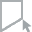
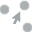
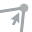
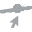

In [9]:
report

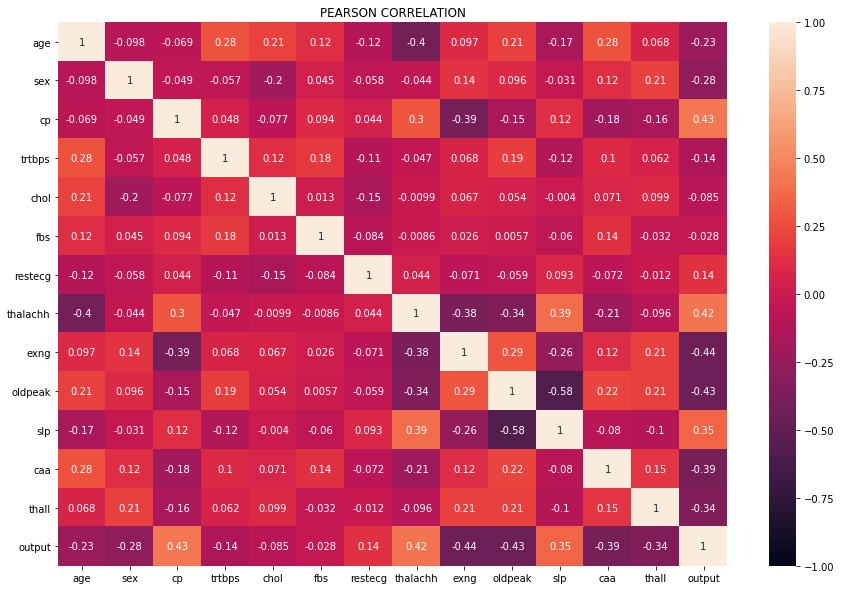

In [7]:
pearson_corr = df.corr()

figure = plt.figure(figsize=(15,10))
sns.heatmap(pearson_corr,annot=True, vmin=-1, vmax=+1)
plt.title("PEARSON CORRELATION")
plt.show()

# Paso 02

Este paso es muy general y contará con menos hints o tips debido a que usted está afrontando el reto final de la sesión. Usted deberá generar los siguientes modelos de Machine Learning para clalsificar nuevos casos con la posibilidad de desarrollar un infarto. En este primer paso deberá generar un __Modelo de Regresión Logística__ que:
- Logre predecir nuevos casos (variable output con un 1), dadas las demas variables disponibles

# Paso 03

Este paso es muy general y contará con menos hints o tips debido a que usted está afrontando el reto final de la sesión. Usted deberá generar los siguientes modelos de Machine Learning para clalsificar nuevos casos con la posibilidad de desarrollar un infarto. En este primer paso deberá generar un __Modelo de Random Forest__ que:
- Logre predecir nuevos casos (variable output con un 1), dadas las demas variables disponibles

Apoyese de alguna o varias de las siguientes librerías

In [10]:
!pip install jcopml

  Created wheel for jcopml: filename=jcopml-1.1.14-py2.py3-none-any.whl size=33654 sha256=b84d602acf4c5e300e91cd013babe3a21fd1713e139f3198c53ee2c10fde8d99
  Stored in directory: c:\users\jaffo\appdata\local\pip\cache\wheels\92\4b\4c\96fbfd74439658c8af474c72f8dea8fbc1a81034dc5ae6371f
Successfully built jcopml


In [11]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,Normalizer,MinMaxScaler,RobustScaler,PolynomialFeatures,PowerTransformer,OneHotEncoder,OrdinalEncoder
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix,classification_report
#from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import scipy.stats as st

from jcopml.plot import plot_correlation_matrix,plot_classification_report,plot_confusion_matrix,plot_residual,plot_association_matrix
from jcopml.tuning import grid_search_params as gsp, random_search_params as rsp, bayes_search_params as bsp
#from jcopml.feature_importance import mean_score_decrease
from skopt import BayesSearchCV
from jcopml.tuning.space import Integer,Real

In [16]:
# Remover duplicados
duplicate_df = df[df.duplicated()]
print(" number of duplicate rows: ", duplicate_df.shape )

df = df.drop_duplicates()

 number of duplicate rows:  (1, 14)


In [12]:
from sklearn.model_selection import train_test_split
X = df.drop(columns='output')
y = df['output']


X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,stratify=y,random_state=42)
X_train.shape,X_test.shape,y_train.shape,y_test.shape

((242, 13), (61, 13), (242,), (61,))

In [13]:
num_pipe = Pipeline([("scaler",StandardScaler()),
                    ("transform",PowerTransformer(method='yeo-johnson'))])


cat_pipe = Pipeline([("encoder",OneHotEncoder())])

In [14]:
preprosesor = ColumnTransformer([("numeric",num_pipe,['age','trtbps','chol','thalachh','oldpeak','thall']),
                              
                               ("category",cat_pipe,['sex','fbs','cp','restecg','exng', 'slp','caa'])])


pipeline = Pipeline([("prep",preprosesor),
                    ("algo",RandomForestClassifier(random_state=42,n_jobs=-1))])

parameter_rf = {'algo__n_estimators': [100, 150, 200],
 'algo__max_depth': [20, 50, 80],
 'algo__max_features': [0.3, 0.6, 0.8],
 'algo__min_samples_leaf': [1, 5, 10]}

rf = GridSearchCV(pipeline,parameter_rf,cv=3,n_jobs=-1,verbose=1)
rf.fit(X_train,y_train)

# evaluacion
print(rf.best_params_)
print(rf.score(X_train,y_train),rf.best_score_,rf.score(X_test,y_test))

Fitting 3 folds for each of 81 candidates, totalling 243 fits
{'algo__max_depth': 20, 'algo__max_features': 0.6, 'algo__min_samples_leaf': 10, 'algo__n_estimators': 100}
0.8801652892561983 0.8472222222222222 0.819672131147541


In [15]:
preprosesor = ColumnTransformer([("numeric",num_pipe,['age','trtbps','chol','thalachh','oldpeak','thall']),
                              
                               ("category",cat_pipe,['sex','fbs','cp','restecg','exng', 'slp','caa'])])


pipeline = Pipeline([("prep",preprosesor),
                    ("algo",LogisticRegression(multi_class='multinomial',solver='lbfgs',n_jobs=-1,random_state=42))])

parameter_logreg = {'algo__fit_intercept': [True, False],
 'algo__C': np.logspace(-3,3,7)}

logreg = GridSearchCV(pipeline,parameter_logreg,cv=3,n_jobs=-1,verbose=1)
logreg.fit(X_train,y_train)

# evaluacion
print(logreg.best_params_)
print(logreg.score(X_train,y_train),logreg.best_score_,logreg.score(X_test,y_test))

Fitting 3 folds for each of 14 candidates, totalling 42 fits
{'algo__C': 0.1, 'algo__fit_intercept': False}
0.8760330578512396 0.8555555555555555 0.8524590163934426


# Paso 03

Este paso es muy general y contará con menos hints o tips debido a que usted está afrontando el reto final de la sesión. Usted deberá generar los siguientes modelos de Machine Learning para clalsificar nuevos casos con la posibilidad de desarrollar un infarto. En este primer paso deberá generar un __Modelo de Clusterización (KNN visto en la sesión 03)__ que:
- Logre predecir nuevos casos (variable output con un 1), dadas las demas variables disponibles

In [16]:
preprosesor = ColumnTransformer([("numeric",num_pipe,['age','trtbps','chol','thalachh','oldpeak','thall']),
                              
                               ("category",cat_pipe,['sex','fbs','cp','restecg','exng', 'slp','caa'])])


pipeline = Pipeline([("prep",preprosesor),
                    ("algo",KNeighborsClassifier())])

parameter_knn = {'algo__n_neighbors': np.arange(1,30,2),
 'algo__weights': ['uniform', 'distance'],
 'algo__p': [1, 1.5, 2]}

knn = GridSearchCV(pipeline,parameter_knn,cv=3,n_jobs=-1,verbose=1)
knn.fit(X_train,y_train)

# Evaluation
print(knn.best_params_)
print(knn.score(X_train,y_train),knn.best_score_,knn.score(X_test,y_test))

Fitting 3 folds for each of 90 candidates, totalling 270 fits
{'algo__n_neighbors': 5, 'algo__p': 1, 'algo__weights': 'uniform'}
0.8842975206611571 0.8349794238683127 0.819672131147541


# Paso 04
Ahora, compare sus modelos de la siguiente manera:
- Puede generar matrices de confusión para cada modelo
- Generar un loop que verifique el nivel de precisión para cada modelo estimado

Después de ello, argumente que modelo elige usted y porque

In [17]:
models = [knn,rf,logreg]
train_accuracy = []
test_accuracy = []

for i in models:
    y_pred_train = i.predict(X_train)
    accuracy_train = accuracy_score(y_train,y_pred_train)
    train_accuracy.append(accuracy_train)
    y_pred_test = i.predict(X_test)
    accuracy_test = accuracy_score(y_test,y_pred_test)
    test_accuracy.append(accuracy_test)

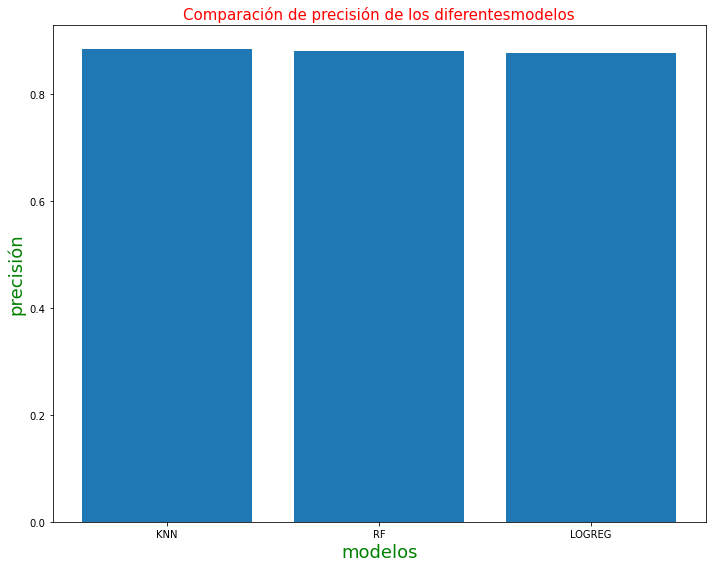

In [18]:
plt.figure(figsize=(10,8))
plt.bar([ 'KNN', 'RF', 'LOGREG'], train_accuracy)
plt.title('Comparación de precisión de los diferentesmodelos', fontsize=15, color='r')
plt.xlabel('modelos', fontsize=18, color='g')
plt.ylabel('precisión', fontsize=18, color='g')
plt.tight_layout()
plt.show()

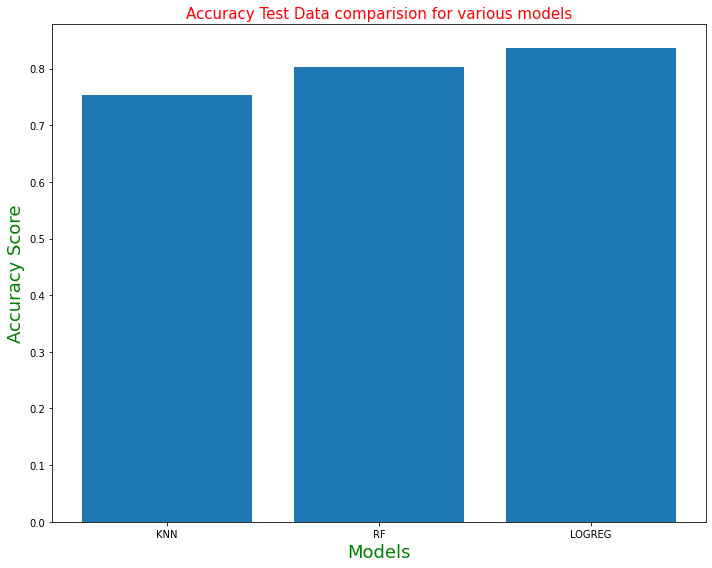

In [24]:
plt.figure(figsize=(10,8))
plt.bar(['KNN', 'RF', 'LOGREG'], test_accuracy)
plt.title('Accuracy Test Data comparision for various models', fontsize=15, color='r')
plt.xlabel('Models', fontsize=18, color='g')
plt.ylabel('Accuracy Score', fontsize=18, color='g')
plt.tight_layout()
plt.show()